<a href="https://colab.research.google.com/github/cengishasan/Multispectral-Edge-Filtered-Conditional-GAN/blob/master/cloudremoval_MEcGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Download Dataset

In [7]:
from google_drive_downloader import GoogleDriveDownloader as gdd
gdd.download_file_from_google_drive(file_id='15HFb7d6EBYsD5xLBU4wlqSIOFK4-arjc',dest_path='./dataset.zip',unzip=True)

Unzipping...Done.


You can also download the dataset from Google Drive or Dropbox links:

1) https://drive.google.com/file/d/15HFb7d6EBYsD5xLBU4wlqSIOFK4-arjc/view?usp=sharing

2) https://www.dropbox.com/s/rxuxccbsbgt3ouu/dataset.zip?dl=0

# Import Required Libraries

In [22]:
from __future__ import absolute_import, division, print_function, unicode_literals
%tensorflow_version 2.x
import tensorflow as tf
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))
import numpy as np
import cv2
import progressbar
import datetime
import os
import time
import matplotlib

from datetime import datetime
from matplotlib import pyplot as plt
from IPython import display

%config IPCompleter.greedy=True

Found GPU at: /device:GPU:0


# Prepare Data Piplines

In [23]:
dir_rgb = 'dataset/RGB'
dir_nir = 'dataset/NIR'
dir_clouds = 'dataset/clouds'

rgb_images = sorted(os.listdir(dir_rgb))
rgb_images.remove('.DS_Store')
cloud_images = sorted(os.listdir(dir_clouds))
cloud_images.remove('.DS_Store')
nir_images = sorted(os.listdir(dir_nir))
nir_images.remove('.DS_Store')

num_images = 528
train_num_images = 428

nir_cloud_intensity = 0.99

print('Prepare Training Dataset')
train_dataset_target_cloudfree_rgb = []
train_dataset_clouded_rgb = []
train_dataset_clouded_nir = []
pbar = progressbar.ProgressBar(maxval=train_num_images)
for i in range(train_num_images):
    target_cloudfree_rgb = plt.imread(os.path.join(dir_rgb, rgb_images[i])).astype(np.float32)
    target_cloudfree_rgb = cv2.normalize(target_cloudfree_rgb, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)

    cloud = plt.imread(os.path.join(dir_clouds, cloud_images[i])).astype(np.float32)
    cloud = 255 * cloud
    cloud[:, :, 3] = np.clip(cloud[:, :, 3] + 75.0, 0, 255.0)
    alpha = cloud[:, :, 3] / 255.0
    alpha = np.broadcast_to(alpha[:, :, None], alpha.shape + (3,))

    # Merge RGB image with the selected cloud image.
    clouded_rgb = (1. - alpha) * target_cloudfree_rgb + alpha * np.ones([256, 256, 3])
    target_cloudfree_rgb = 2 * target_cloudfree_rgb - 1
    clouded_rgb = 2 * clouded_rgb - 1

    # Merge NIR image with the selected cloud image.    
    nir = plt.imread(os.path.join(dir_nir, nir_images[i])).astype(np.float32)
    nir = cv2.normalize(nir, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
    nir_cloud = cloud[:, :, 3] / 255
    clouded_nir = (1. - nir_cloud_intensity * nir_cloud) * nir + nir_cloud_intensity * nir_cloud * np.ones([256, 256])
    clouded_nir = 2 * clouded_nir - 1

    train_dataset_target_cloudfree_rgb.append(target_cloudfree_rgb.astype(np.float32))
    train_dataset_clouded_rgb.append(clouded_rgb.astype(np.float32))
    train_dataset_clouded_nir.append(clouded_nir.astype(np.float32))    
    pbar.update(i+1)

train_dataset_target_cloudfree_rgb = tf.data.Dataset.from_tensor_slices(train_dataset_target_cloudfree_rgb)
train_dataset_clouded_rgb = tf.data.Dataset.from_tensor_slices(train_dataset_clouded_rgb)
train_dataset_clouded_nir = tf.data.Dataset.from_tensor_slices(train_dataset_clouded_nir)
train_dataset = tf.data.Dataset.zip((train_dataset_clouded_rgb, train_dataset_target_cloudfree_rgb, train_dataset_clouded_nir))
pbar.finish()

print('Prepare Test Dataset')
test_dataset_target_cloudfree_rgb = []
test_dataset_clouded_rgb = []
test_dataset_clouded_nir = []
pbar = progressbar.ProgressBar(maxval=num_images-train_num_images)
for i in range(train_num_images, num_images):
    target_cloudfree_rgb = plt.imread(os.path.join(dir_rgb, rgb_images[i])).astype(np.float32)
    target_cloudfree_rgb = cv2.normalize(target_cloudfree_rgb, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)

    cloud = plt.imread(os.path.join(dir_clouds, cloud_images[i])).astype(np.float32)
    cloud = 255 * cloud
    cloud[:, :, 3] = np.clip(cloud[:, :, 3] + 75.0, 0, 255.0)
    alpha = cloud[:, :, 3] / 255.0
    alpha = np.broadcast_to(alpha[:, :, None], alpha.shape + (3,))

    # Merge RGB image with the selected cloud image.
    clouded_rgb = (1. - alpha) * target_cloudfree_rgb + alpha * np.ones([256, 256, 3])
    target_cloudfree_rgb = 2 * target_cloudfree_rgb - 1
    clouded_rgb = 2 * clouded_rgb - 1

    # Merge NIR image with the selected cloud image.
    nir = plt.imread(os.path.join(dir_nir, nir_images[i])).astype(np.float32)
    nir = cv2.normalize(nir, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
    nir_cloud = cloud[:, :, 3] / 255
    clouded_nir = (1. - nir_cloud_intensity * nir_cloud) * nir + nir_cloud_intensity * nir_cloud * np.ones([256, 256])
    clouded_nir = 2 * clouded_nir - 1

    test_dataset_target_cloudfree_rgb.append(target_cloudfree_rgb.astype(np.float32))
    test_dataset_clouded_rgb.append(clouded_rgb.astype(np.float32))
    test_dataset_clouded_nir.append(clouded_nir.astype(np.float32))
    pbar.update(i - train_num_images + 1)

test_dataset_target_cloudfree_rgb = tf.data.Dataset.from_tensor_slices(test_dataset_target_cloudfree_rgb)
test_dataset_clouded_rgb = tf.data.Dataset.from_tensor_slices(test_dataset_clouded_rgb)
test_dataset_clouded_nir = tf.data.Dataset.from_tensor_slices(test_dataset_clouded_nir)
test_dataset = tf.data.Dataset.zip((test_dataset_clouded_rgb, test_dataset_target_cloudfree_rgb, test_dataset_clouded_nir))
pbar.finish()

  1% (6 of 428) |                        | Elapsed Time: 0:00:00 ETA:   0:00:07

Prepare Training Dataset


100% (428 of 428) |######################| Elapsed Time: 0:01:25 Time:  0:01:25
  7% (7 of 100) |#                       | Elapsed Time: 0:00:00 ETA:   0:00:01

Prepare Test Dataset


100% (100 of 100) |######################| Elapsed Time: 0:00:19 Time:  0:00:19


# GAN Architecture

## Single Decoder and Encoder Layers

In [32]:
# Single decoder layer 
def downsample(filters, size, apply_batchnorm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    result.add(
        tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                               kernel_initializer=initializer, use_bias=False))
    if apply_batchnorm:
        result.add(tf.keras.layers.BatchNormalization())
        result.add(tf.keras.layers.LeakyReLU())
    return result

# Single encoder layer
def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                               padding='same',
                                               kernel_initializer=initializer,
                                               use_bias=False))
    result.add(tf.keras.layers.BatchNormalization())
    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))

    result.add(tf.keras.layers.ReLU())
    return result

## Generator Architecture and Loss

In [33]:
OUTPUT_CHANNELS = 3
def Generator():
    clouded_rgb = tf.keras.layers.Input(shape=[256, 256, 3], name='clouded_rgb')
    clouded_nir = tf.keras.layers.Input(shape=[256, 256, 1], name='clouded_nir')
    down_stack = [
        downsample(64, 4, apply_batchnorm=False),
        downsample(128, 4),
        downsample(256, 4),
        downsample(512, 4),
        downsample(512, 4),
        downsample(512, 4),
        downsample(512, 4),
        downsample(512, 4),
    ]
    up_stack = [
        upsample(512, 4, apply_dropout=True),
        upsample(512, 4, apply_dropout=True),
        upsample(512, 4, apply_dropout=True),
        upsample(512, 4),
        upsample(256, 4),
        upsample(128, 4),
        upsample(64, 4),
    ]
    initializer = tf.random_normal_initializer(0., 0.02)
    last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                           strides=2,
                                           padding='same',
                                           kernel_initializer=initializer,
                                           activation='tanh')  # (bs, 256, 256, 3)
    x = tf.keras.layers.concatenate([clouded_rgb, clouded_nir])
    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
    skips = reversed(skips[:-1])
    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = tf.keras.layers.Concatenate()([x, skip])
    x = last(x)
    return tf.keras.Model(inputs=[clouded_rgb, clouded_nir], outputs=x)

LAMBDA = 1

def generator_loss(disc_generated_output, generated_cloudfree_rgb, target_cloudfree_rgb):
    gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)
    # mean absolute error
    l1_loss = tf.reduce_mean(tf.abs(target_cloudfree_rgb - generated_cloudfree_rgb))
    total_gen_loss = gan_loss + LAMBDA * l1_loss
    return total_gen_loss, gan_loss, l1_loss

## Discriminator Architecture and Loss

In [34]:
def Discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)
    # edge_clouded_nir = tf.keras.layers.Input(shape=[256, 256, 1], name='edge_clouded_nir')
    cloud_free_rgb = tf.keras.layers.Input(shape=[256, 256, 3], name='cloud_free_rgb')
    edge_cloud_free_rgb = tf.keras.layers.Input(shape=[256, 256, 1], name='edge_cloud_free_rgb')
    # gray_edge_clouded_rgb = tf.keras.layers.Input(shape=[256, 256, 1], name='gray_edge_clouded_rgb')
    x = tf.keras.layers.concatenate([cloud_free_rgb, edge_cloud_free_rgb])
    down1 = downsample(64, 3, False)(x)
    down2 = downsample(128, 3)(down1)
    down3 = downsample(128, 3)(down2)
    down4 = downsample(256, 3)(down3)
    down5 = downsample(256, 3)(down4)
    down6 = downsample(512, 3)(down5)
    down7 = downsample(512, 3)(down6)
    zero_pad1 = tf.keras.layers.ZeroPadding2D()(down7)
    conv = tf.keras.layers.Conv2D(512, 3, strides=1,
                                  kernel_initializer=initializer,
                                  use_bias=False)(zero_pad1)
    batchnorm1 = tf.keras.layers.BatchNormalization()(conv)
    leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)
    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)
    layer10 = tf.keras.layers.Conv2D(1, 3, strides=1,
                                     kernel_initializer=initializer)(zero_pad2)
    flatten_layer = tf.keras.layers.Flatten()(layer10)
    dense = tf.keras.layers.Dense(1)(flatten_layer)
    return tf.keras.Model(inputs=[cloud_free_rgb, edge_cloud_free_rgb], outputs=tf.keras.activations.sigmoid(dense))

loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(disc_real_output, disc_generated_output):
    real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)
    generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss

# Visualize Images

In [35]:
def display_images(generated_cloudfree_rgb, test_input, target_cloudfree_rgb):
    plt.figure(figsize=(15,15))
    display_list = [test_input[0][0], test_input[1][0,:,:,0], target_cloudfree_rgb[0], generated_cloudfree_rgb[0]]
    title = ['Clouded RGB', 'Clouded NIR', 'Target Cloud-free RGB', 'Generated Cloud-free RGB']
    for i in range(4):
        plt.subplot(1, 4, i+1)
        plt.title(title[i])
        # getting the pixel values between [0, 1] to plot it.
        if i==1:
            plt.imshow((display_list[i].numpy() + 1)/2.0, cmap='gray')
        else:
            plt.imshow((display_list[i].numpy() + 1)/2.0)
        plt.axis('off')
    plt.show()

# Training

In [36]:
@tf.function
def train_step(clouded_rgb, target_cloudfree_rgb, clouded_nir, epoch):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_cloudfree_rgb = generator([clouded_rgb[None, :, :, :], clouded_nir[None, :, :, None]], training=True)

        gray_generated_cloudfree_rgb = tf.image.rgb_to_grayscale(generated_cloudfree_rgb)
        sobel = tf.image.sobel_edges(gray_generated_cloudfree_rgb)
        gray_edge_generated_cloudfree_rgb = sobel[:, :, :, :, 0] 

        gray_target_cloudfree_rgb = tf.image.rgb_to_grayscale(target_cloudfree_rgb[None, :, :, :])
        gray_edge_target_cloudfree_rgb = tf.image.sobel_edges(gray_target_cloudfree_rgb)
        gray_edge_target_cloudfree_rgb = gray_edge_target_cloudfree_rgb[:, :, :, :, 0]

        disc_real_output = discriminator([target_cloudfree_rgb[None, :, :, :], gray_edge_target_cloudfree_rgb], training=True)
        disc_generated_output = discriminator([generated_cloudfree_rgb, gray_edge_generated_cloudfree_rgb], training=True)

        gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, generated_cloudfree_rgb,
                                                                   target_cloudfree_rgb)
        disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

    generator_gradients = gen_tape.gradient(gen_total_loss,
                                            generator.trainable_variables)
    discriminator_gradients = disc_tape.gradient(disc_loss,
                                                 discriminator.trainable_variables)
    generator_optimizer.apply_gradients(zip(generator_gradients,
                                            generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                                discriminator.trainable_variables))
    with summary_writer.as_default():
        tf.summary.scalar('gen_total_loss', gen_total_loss, step=epoch)
        tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=epoch)
        tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=epoch)
        tf.summary.scalar('disc_loss', disc_loss, step=epoch)

dir_generated_cloud_free_images = 'results/' + 'generated_cloud_free_images_' + str(nir_cloud_intensity * 100) + 'eta_NIR'
try:
    os.makedirs(dir_generated_cloud_free_images)
except OSError:
    print("Directory %s already exists" % dir_generated_cloud_free_images)

def fit(train_ds, test_ds, start_from_epoch):
    len_epochs = 10 ** (len(str(EPOCHS)))
    for epoch in range(start_from_epoch - 1, EPOCHS):
        print("Epoch: ", epoch + 1)
        pbar = progressbar.ProgressBar(maxval=train_num_images)
        idx = 1
        for _, all_images_in_batch in train_ds.enumerate():
            train_step(all_images_in_batch[0], all_images_in_batch[1], all_images_in_batch[2], epoch)
            pbar.update(idx)
            idx = idx + 1
        pbar.finish()

        # saving generated cloud-free rgb images in every 50 epochs
        if (epoch + 1) % 50 == 0:
            id_im = 1
            for example_clouded_rgb_image, example_target_cloudfree_rgb_image, example_clouded_nir in test_ds.take(num_images - train_num_images):
                generated_cloud_free_image = generator([example_clouded_rgb_image[None, :, :, :], example_clouded_nir[None, :, :, None]], training=True)                
                matplotlib.image.imsave(dir_generated_cloud_free_images + '/' + 'generated_cloud_free_rgb' + str(len_epochs + epoch + 1)[1:] + '_' + str(10 * (num_images - train_num_images) + id_im)[1:] + '.png', (1 + generated_cloud_free_image[0].numpy()) / 2)
                # visualize generated cloud-free rgb images
                display_images(generated_cloud_free_image, [example_clouded_rgb_image[None,:,:,:], example_clouded_nir[None,:,:,None]], example_target_cloudfree_rgb_image[None,:,:,:])
                id_im = id_im + 1        
        
        # saving (checkpoint) the model in every 20 epochs
        if (epoch + 1) % 20 == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

    checkpoint.save(file_prefix=checkpoint_prefix)

Directory results/generated_cloud_free_images_99.0eta_NIR already exists


# Fit Data

In [37]:
generator = Generator()
discriminator = Discriminator()
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

Directory ./training_checkpoints already exists
Epoch:  1


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  2


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  3


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  4


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  5


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  6


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  7


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  8


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  9


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  10


100% (428 of 428) |######################| Elapsed Time: 0:01:07 Time:  0:01:07


Epoch:  11


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  12


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  13


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  14


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  15


100% (428 of 428) |######################| Elapsed Time: 0:01:07 Time:  0:01:07


Epoch:  16


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  17


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  18


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  19


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  20


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  21


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  22


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  23


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  24


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  25


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  26


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  27


100% (428 of 428) |######################| Elapsed Time: 0:01:07 Time:  0:01:07


Epoch:  28


100% (428 of 428) |######################| Elapsed Time: 0:01:07 Time:  0:01:07


Epoch:  29


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  30


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  31


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  32


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  33


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  34


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  35


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  36


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  37


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  38


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  39


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  40


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  41


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  42


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  43


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  44


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  45


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  46


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  47


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  48


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  49


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  50


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


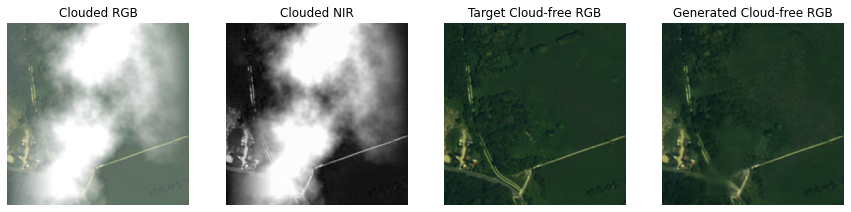

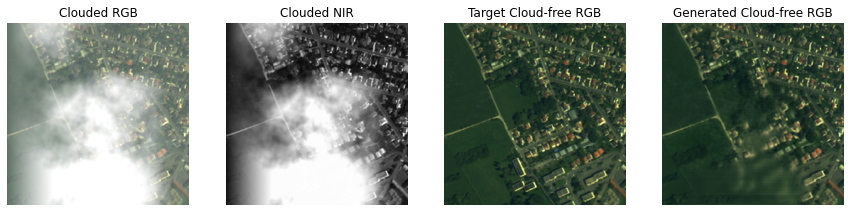

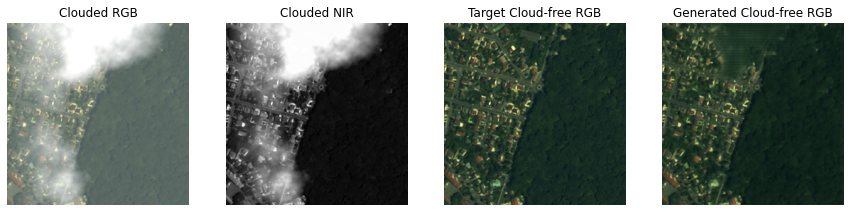

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


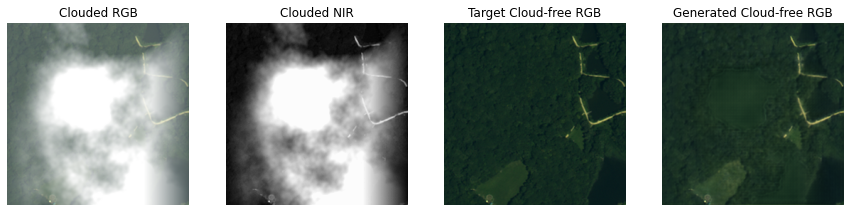

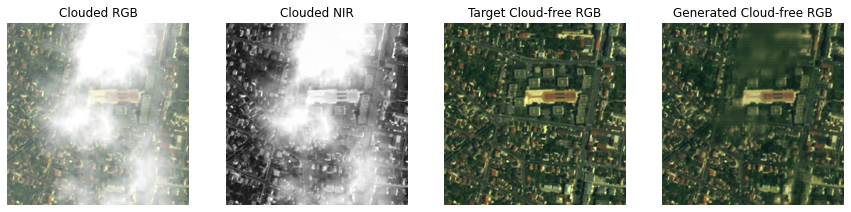

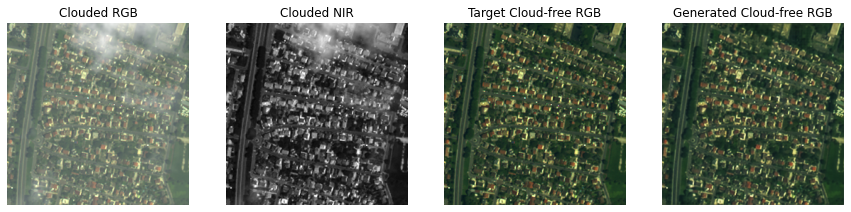

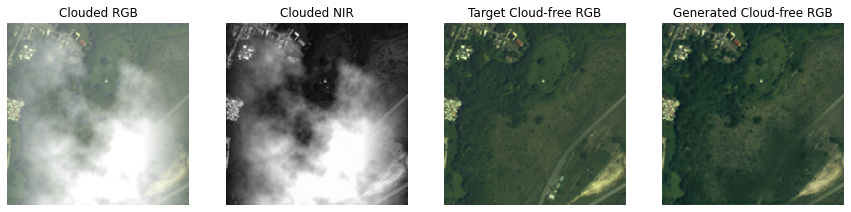

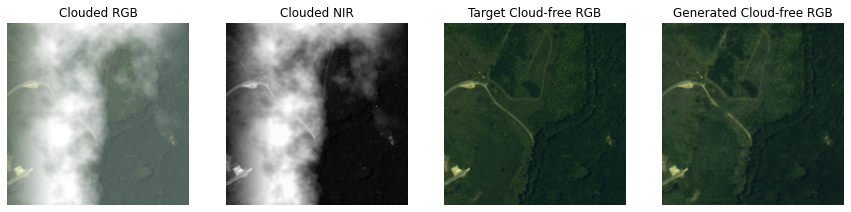

...

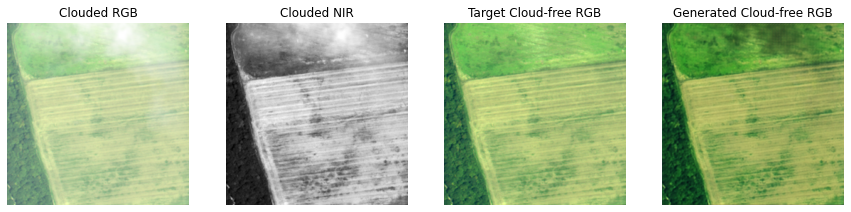

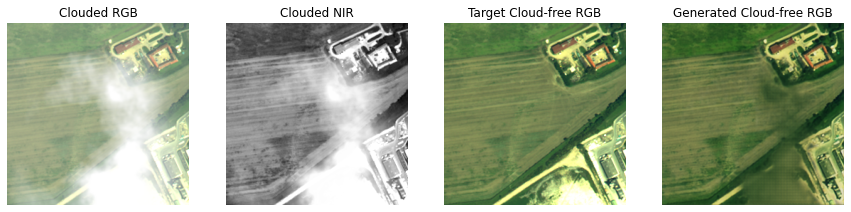

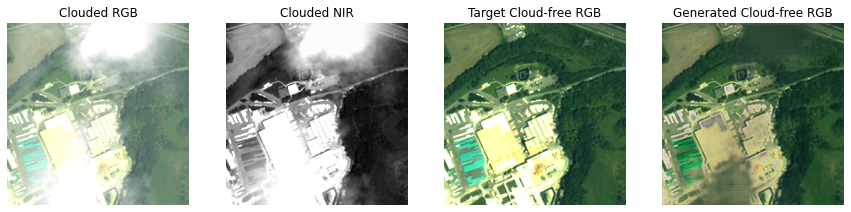

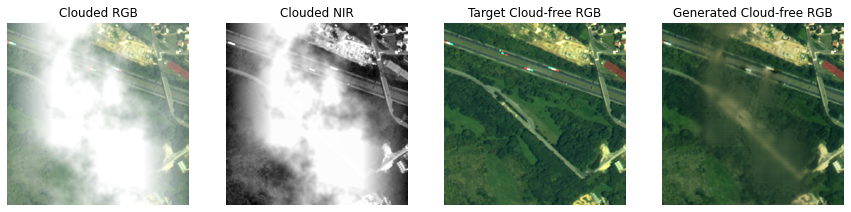

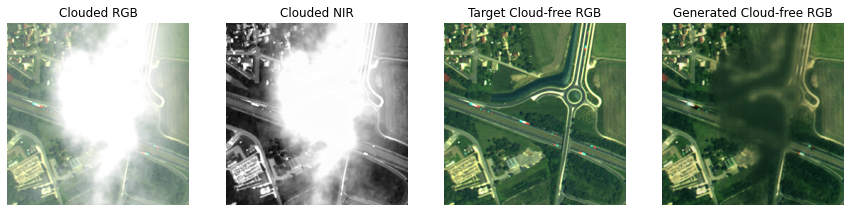

Epoch:  51


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  52


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  53


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  54


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  55


100% (428 of 428) |######################| Elapsed Time: 0:01:07 Time:  0:01:07


Epoch:  56


100% (428 of 428) |######################| Elapsed Time: 0:01:06 Time:  0:01:06


Epoch:  57


 81% (347 of 428) |#################     | Elapsed Time: 0:00:54 ETA:   0:00:12

Buffered data was truncated after reaching the output size limit.

In [ ]:
log_dir = 'logs/'
summary_writer = tf.summary.create_file_writer(log_dir + 'fit/' + datetime.now().strftime("%Y%m%d-%H%M%S"))

checkpoint_dir = './training_checkpoints'
try:
    os.mkdir(checkpoint_dir)
except OSError:
    print("Directory %s already exists" % checkpoint_dir)

checkpoint_prefix = os.path.join(checkpoint_dir, 'ckpt')

restore_checkpoint = False # To restore last checkpoint, set this to True 
if restore_checkpoint is False:
    checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)
    checkpoint_path = checkpoint_dir + '/training/cp-{epoch:04d}.ckpt'
else:
    checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))
    
EPOCHS = 500
start_from_epoch = 1
fit(train_dataset, test_dataset, start_from_epoch)